# P7 : Implémentez un modèle de scoring

## Importation librairies

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
pd.set_option("display.max_rows", 101)
pd.options.display.max_columns = 999
# from sklearn import *
from sklearnex import patch_sklearn
patch_sklearn

<function sklearnex.dispatcher.patch_sklearn(name=None, verbose=True, global_patch=False)>

## Organigramme

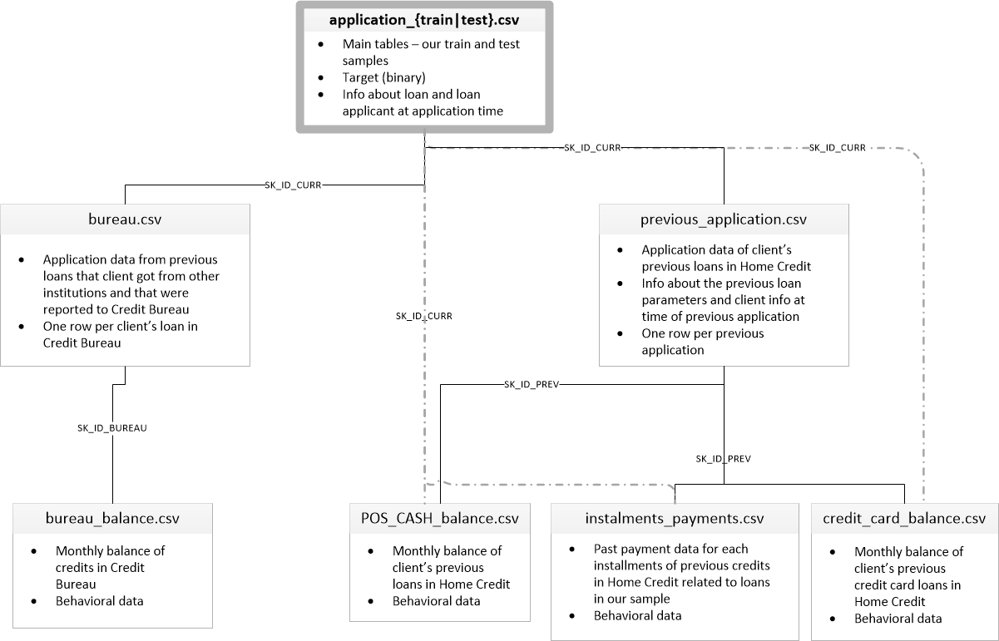

## Fonction de Réduction du poids des fichiers pendant le loading

In [2]:
# réf = https://www.kaggle.com/code/rinnqd/reduce-memory-usage/notebook

def reduce_mem_usage(df):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2
    
    print('Memory usage of dataframe is: {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtypes
        
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))

    return df

## Chemin d'accès & datasets

In [3]:
path = 'C:\\Users\\Rahamane\\OneDrive\\Documents\\DataScientist OC\\PROJET\\PROJET 7\\Projet+Mise+en+prod+-+home-credit-default-risk\\'
# path = 'C:\\Users\\mhrah\\OneDrive\\Documents\\DataScientist OC\\PROJET\\PROJET 7\\Projet+Mise+en+prod+-+home-credit-default-risk\\'

In [4]:
train_df = reduce_mem_usage(pd.read_csv(path + 'application_train.csv'))
print('Number of data points:', train_df.shape[0])
print('Number of features:', train_df.shape[1])
train_df.head()

Memory usage of dataframe is: 286.23 MB
Memory usage after optimization is: 92.38 MB
Decreased by 67.7%
Number of data points: 307511
Number of features: 122


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018799,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083008,0.262939,0.139404,0.024704,0.036896,0.972168,0.619141,0.014297,0.000000,0.068970,0.083313,0.125000,0.036896,0.020203,0.018997,0.000000,0.000000,0.025208,0.038300,0.972168,0.634277,0.014397,0.000000,0.068970,0.083313,0.125000,0.037689,0.022003,0.019806,0.0,0.0,0.024994,0.036896,0.972168,0.624512,0.014397,0.000000,0.068970,0.083313,0.125000,0.037506,0.020493,0.019302,0.000000,0.000000,reg oper account,block of flats,0.014900,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003542,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311279,0.622070,NaN,0.095886,0.052887,0.984863,0.795898,0.060486,0.080017,0.034485,0.291748,0.333252,0.013000,0.077271,0.054901,0.003901,0.009804,0.092407,0.053802,0.984863,0.804199,0.049713,0.080627,0.034485,0.291748,0.333252,0.012802,0.078979,0.055389,0.0,0.0,0.096802,0.052887,0.984863,0.798828,0.060791,0.080017,0.034485,0.291748,0.333252,0.013199,0.078674,0.055786,0.003901,0.010002,reg oper account,block of flats,0.071411,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010033,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,

In [5]:
font_title = {"family": "serif",
              "color":  "#476bff",
              "weight": "bold",
              "size": 18}

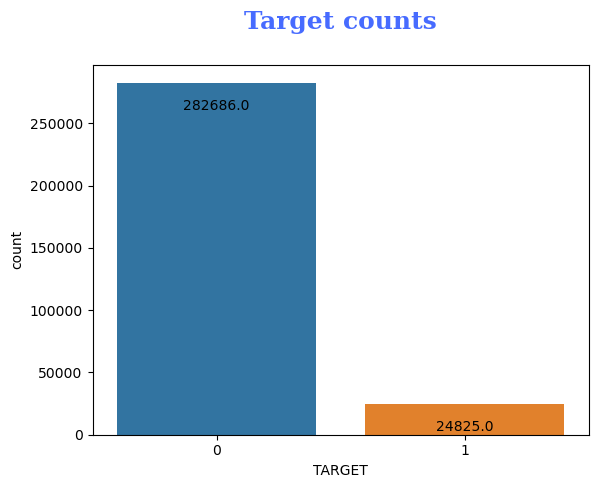

In [6]:
plt.title(f"Target counts\n",
          fontdict=font_title)
ax = sns.countplot(data=train_df, x="TARGET")
# Add count labels
for p in ax.patches:
    ax.annotate(f'\n{p.get_height()}', (p.get_x()+0.4, p.get_height()), ha='center', va='top', color='black')

plt.show()

In [7]:
test_df = reduce_mem_usage(pd.read_csv(path + 'application_test.csv'))
print('Number of data points:', test_df.shape[0])
print('Number of features:', test_df.shape[1])
test_df.head()

Memory usage of dataframe is: 45.00 MB
Memory usage after optimization is: 14.60 MB
Decreased by 67.6%
Number of data points: 48744
Number of features: 121


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018845,-19241,-2329,-5168.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752441,0.789551,0.159546,0.065979,0.058990,0.973145,NaN,NaN,NaN,0.137939,0.125,NaN,NaN,NaN,0.050507,NaN,NaN,0.067200,0.061188,0.973145,NaN,NaN,NaN,0.137939,0.125,NaN,NaN,NaN,0.052612,NaN,NaN,0.066589,0.058990,0.973145,NaN,NaN,NaN,0.137939,0.125,NaN,NaN,NaN,0.051392,NaN,NaN,NaN,block of flats,0.039215,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035797,-18064,-4469,-9120.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564941,0.291748,0.432861,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019104,-20038,-4458,-2176.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699707,0.610840,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secon

In [8]:
bureau_df = reduce_mem_usage(pd.read_csv(path + 'bureau.csv'))
print('Number of data points:', bureau_df.shape[0])
print('Number of features:', bureau_df.shape[1])
bureau_df.head()

Memory usage of dataframe is: 222.62 MB
Memory usage after optimization is: 112.95 MB
Decreased by 49.3%
Number of data points: 1716428
Number of features: 17


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [9]:
bureau_balance = reduce_mem_usage(pd.read_csv(path + 'bureau_balance.csv'))
print('Number of data points:', bureau_balance.shape[0])
print('Number of features:', bureau_balance.shape[1])
bureau_balance.head()

Memory usage of dataframe is: 624.85 MB
Memory usage after optimization is: 338.46 MB
Decreased by 45.8%
Number of data points: 27299925
Number of features: 3


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [10]:
previous_application = reduce_mem_usage(pd.read_csv(path + 'previous_application.csv'))
print('Number of data points:', previous_application.shape[0])
print('Number of features:', previous_application.shape[1])
previous_application.head()

Memory usage of dataframe is: 471.48 MB
Memory usage after optimization is: 309.01 MB
Decreased by 34.5%
Number of data points: 1670214
Number of features: 37


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430054,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182861,0.867188,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615234,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735352,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335938,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.394531,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
pos_cash_balance = reduce_mem_usage(pd.read_csv(path + 'POS_CASH_balance.csv'))
print('Number of data points:', pos_cash_balance.shape[0])
print('Number of features:', pos_cash_balance.shape[1])
pos_cash_balance.head()

Memory usage of dataframe is: 610.43 MB
Memory usage after optimization is: 238.45 MB
Decreased by 60.9%
Number of data points: 10001358
Number of features: 8


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [12]:
installments_payments = reduce_mem_usage(pd.read_csv(path + 'installments_payments.csv'))
print('Number of data points:', installments_payments.shape[0])
print('Number of features:', installments_payments.shape[1])
installments_payments.head()

Memory usage of dataframe is: 830.41 MB
Memory usage after optimization is: 311.40 MB
Decreased by 62.5%
Number of data points: 13605401
Number of features: 8


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.359863,6948.359863
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525024,1716.525024
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000000,25425.000000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130859,24350.130859
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040039,2160.584961


In [13]:
credit_card_balance = reduce_mem_usage(pd.read_csv(path + 'credit_card_balance.csv'))
print('Number of data points:', credit_card_balance.shape[0])
print('Number of features:', credit_card_balance.shape[1])
credit_card_balance.head()

Memory usage of dataframe is: 673.88 MB
Memory usage after optimization is: 289.33 MB
Decreased by 57.1%
Number of data points: 3840312
Number of features: 23


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970001,135000,0.0,877.5,0.0,877.5,1700.324951,1800.0,1800.0,0.000000,0.000000,0.000000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.554688,45000,2250.0,2250.0,0.0,0.0,2250.000000,2250.0,2250.0,60175.078125,64875.554688,64875.554688,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.224609,450000,0.0,0.0,0.0,0.0,2250.000000,2250.0,2250.0,26926.425781,31460.085938,31460.085938,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.109375,225000,2250.0,2250.0,0.0,0.0,11795.759766,11925.0,11925.0,224949.281250,233048.968750,233048.968750,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.468750,450000,0.0,11547.0,0.0,11547.0,22924.890625,27000.0,27000.0,443044.406250,453919.468750,453919.468750,0.0,1,0.0,1.0,101.0,Active,0,0


<Axes: >

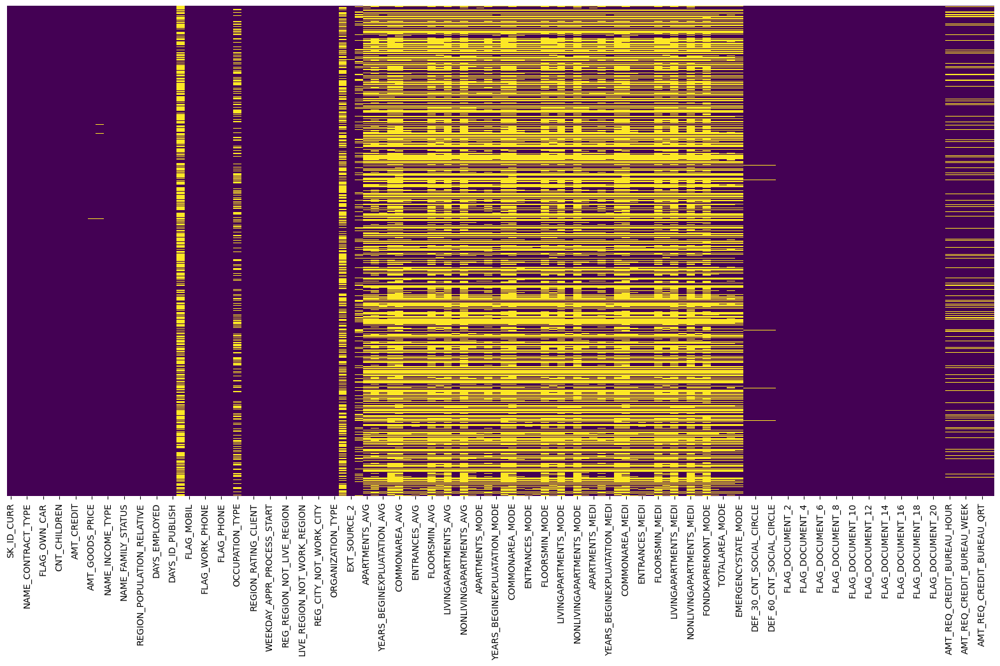

In [14]:
#heatmap showing the distribution of all the Nan's throughout the data
plt.figure(figsize=(20,10))
sns.heatmap(train_df.isnull(), cbar=False, yticklabels=False, cmap = 'viridis')

In [15]:
def data_cleaning(data):
    print("na values available in data \n")
    print(data.isna().sum())
    data = data.dropna()
    print("after droping na values \n")
    print(data.isna().sum())
    return data

In [16]:
train_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018799,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083008,0.262939,0.139404,0.024704,0.036896,0.972168,0.619141,0.014297,0.000000,0.068970,0.083313,0.125000,0.036896,0.020203,0.018997,0.000000,0.000000,0.025208,0.038300,0.972168,0.634277,0.014397,0.000000,0.068970,0.083313,0.125000,0.037689,0.022003,0.019806,0.0,0.0,0.024994,0.036896,0.972168,0.624512,0.014397,0.000000,0.068970,0.083313,0.125000,0.037506,0.020493,0.019302,0.000000,0.000000,reg oper account,block of flats,0.014900,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003542,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311279,0.622070,NaN,0.095886,0.052887,0.984863,0.795898,0.060486,0.080017,0.034485,0.291748,0.333252,0.013000,0.077271,0.054901,0.003901,0.009804,0.092407,0.053802,0.984863,0.804199,0.049713,0.080627,0.034485,0.291748,0.333252,0.012802,0.078979,0.055389,0.0,0.0,0.096802,0.052887,0.984863,0.798828,0.060791,0.080017,0.034485,0.291748,0.333252,0.013199,0.078674,0.055786,0.003901,0.010002,reg oper account,block of flats,0.071411,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010033,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,

In [17]:
def get_metrics(y_true, y_pred, y_pred_prob):
    from sklearn.metrics import accuracy_score,precision_score,recall_score,log_loss
    acc = accuracy_score(y_true, y_pred)
    prec = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    entropy = log_loss(y_true, y_pred_prob)
    return {'accuracy': round(acc, 2), 'precision': round(prec, 2), 'recall': round(recall, 2), 'entropy': round(entropy, 2)}

In [18]:
def create_confusion_matrix_plot(clf, X_test, y_test):
    import matplotlib.pyplot as plt
    from sklearn.metrics import plot_confusion_matrix
    plot_confusion_matrix(clf, X_test, y_test)
    plt.savefig('confusion_matrix.png')

## Feature engineering

In [19]:
import numpy as np
import pandas as pd
import gc
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import re


In [20]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

In [21]:
# One-hot encoding for categorical columns with get_dummies
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

In [22]:
# Preprocess application_train.csv and application_test.csv
def application_train(nan_as_category = False):
    
    df = train_df.copy()
    df = df[df['CODE_GENDER'] != 'XNA']
#     df = df.dropna()
    
#     df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    
    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in df.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    df = df.rename(columns=new_names)
    
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    # Categorical features with One-Hot encode
    df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
    # Some simple new features (percentages)
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']
    
    gc.collect()
    return df

In [23]:
# Preprocess application_train.csv and application_test.csv
def application_test(nan_as_category = False):
    
    df_t = test_df.copy()
    df_t = df_t[df_t['CODE_GENDER'] != 'XNA']
#     df_t = df_t.dropna()
    
#     df_t = df_t.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    
    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in df_t.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    df_t = df_t.rename(columns=new_names)
    
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df_t[bin_feature], uniques = pd.factorize(df_t[bin_feature])
    # Categorical features with One-Hot encode
    df_t, cat_cols = one_hot_encoder(df_t, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    df_t['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
    # Some simple new features (percentages)
    df_t['DAYS_EMPLOYED_PERC'] = df_t['DAYS_EMPLOYED'] / df_t['DAYS_BIRTH']
    df_t['INCOME_CREDIT_PERC'] = df_t['AMT_INCOME_TOTAL'] / df_t['AMT_CREDIT']
    df_t['INCOME_PER_PERSON'] = df_t['AMT_INCOME_TOTAL'] / df_t['CNT_FAM_MEMBERS']
    df_t['ANNUITY_INCOME_PERC'] = df_t['AMT_ANNUITY'] / df_t['AMT_INCOME_TOTAL']
    df_t['PAYMENT_RATE'] = df_t['AMT_ANNUITY'] / df_t['AMT_CREDIT']
    
    gc.collect()
    return df_t


In [24]:
# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(nan_as_category = True):
    bureau = bureau_df.copy()
    bb = bureau_balance.copy()
    
#     bureau = bureau.dropna()
#     bb = bb.dropna()
    
#     bureau = bureau.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in bureau.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    bureau = bureau.rename(columns=new_names)   
    

#     bb = bb.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names_b = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in bb.columns}
    new_n_list_b = list(new_names_b.values())

    # [LightGBM] Feature appears more than one time.
    new_names_b = {col: f'{new_col}_{i}' if new_col in new_n_list_b[:i] else new_col for i, (col, new_col) in enumerate(new_names_b.items())}
    bb = bb.rename(columns=new_names) 
    
    
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
# Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

In [25]:
# Preprocess previous_applications.csv
def previous_applications(nan_as_category = True):
    prev = previous_application.copy()
#     prev = prev.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))   
    
#     prev = prev.dropna()
    
    
    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in prev.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    prev = prev.rename(columns=new_names)
    
    
    
    
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
      
    
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

In [26]:
# Preprocess POS_CASH_balance.csv
def pos_cash(nan_as_category = True):
    pos = pos_cash_balance
    
#     pos = pos.dropna()
#     pos = pos.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

    
    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in pos.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    pos = pos.rename(columns=new_names)
    
    
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg

In [27]:
# Preprocess installments_payments.csv
def installments_pay(nan_as_category = True):
    ins = installments_payments.copy()
    
#     ins = ins.dropna()
    
#     ins = ins.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in ins.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    ins = ins.rename(columns=new_names)
    

    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg


In [28]:
# Preprocess credit_card_balance.csv
def credit_cb(nan_as_category = True):
    cc = credit_card_balance.copy()
    
#     cc = cc.dropna()
    
#     cc = cc.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

    # Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
    new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in cc.columns}
    new_n_list = list(new_names.values())

    # [LightGBM] Feature appears more than one time.
    new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}
    cc = cc.rename(columns=new_names)
    
    
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg

In [29]:
import pickle

In [30]:
# if __name__ == "__main__":
#     submission_file_name = "submission_kernel02.csv"
#     with timer("Full model run"):
#         main()

### Train application

In [31]:
df_train = train_df.copy()

In [32]:
num_rows = 10000
df_train = application_train(num_rows)

In [33]:
with timer("Process bureau and bureau_balance"):
    bureau = bureau_and_balance(num_rows)
    print("Bureau df shape:", bureau.shape)
    df_train = df_train.join(bureau, how='left', on='SK_ID_CURR')
    del bureau
    gc.collect()

Bureau df shape: (305811, 116)
Process bureau and bureau_balance - done in 15s


In [34]:
with timer("Process previous_applications"):
    prev = previous_applications(num_rows)
    print("Previous applications df shape:", prev.shape)
    df_train = df_train.join(prev, how='left', on='SK_ID_CURR')
    del prev
    gc.collect()

Previous applications df shape: (338857, 249)
Process previous_applications - done in 23s


In [35]:
with timer("Process POS-CASH balance"):
    pos = pos_cash(num_rows)
    print("Pos-cash balance df shape:", pos.shape)
    df_train = df_train.join(pos, how='left', on='SK_ID_CURR')
    del pos
    gc.collect()

Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - done in 12s


In [36]:
with timer("Process installments payments"):
    ins = installments_pay(num_rows)
    print("Installments payments df shape:", ins.shape)
    df_train = df_train.join(ins, how='left', on='SK_ID_CURR')
    del ins
    gc.collect()

Installments payments df shape: (339587, 26)
Process installments payments - done in 26s


In [37]:
with timer("Process credit card balance"):
    cc = credit_cb(num_rows)
    print("Credit card balance df shape:", cc.shape)
    df_train = df_train.join(cc, how='left', on='SK_ID_CURR')
    del cc
    gc.collect()

Credit card balance df shape: (103558, 141)
Process credit card balance - done in 10s


In [38]:
df_train.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_nan,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_TYPE_SUITE_nan,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_INCOME_TYPE_nan,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_nan,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_FAMILY_STATUS_nan,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,NAME_HOUSING_TYPE_nan,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,OCCUPATION_TYPE_nan,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,WEEKDAY_APPR_PROCESS_STAR

In [39]:
df_train.isna().sum()

SK_ID_CURR                               0
TARGET                                   0
CODE_GENDER                              0
FLAG_OWN_CAR                             0
FLAG_OWN_REALTY                          0
                                     ...  
CC_NAME_CONTRACT_STATUS_nan_MAX     220602
CC_NAME_CONTRACT_STATUS_nan_MEAN    220602
CC_NAME_CONTRACT_STATUS_nan_SUM     220602
CC_NAME_CONTRACT_STATUS_nan_VAR     221234
CC_COUNT                            220602
Length: 810, dtype: int64

In [40]:
df_train.shape

(307507, 810)

In [41]:
df_train = df_train.fillna(df_train.median())
df_train.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_nan,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_TYPE_SUITE_nan,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_INCOME_TYPE_nan,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_nan,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_FAMILY_STATUS_nan,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,NAME_HOUSING_TYPE_nan,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,OCCUPATION_TYPE_nan,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,WEEKDAY_APPR_PROCESS_STAR

### Test application

In [42]:
df_t = test_df.copy()

In [43]:
num_rows = 10000
df_t = application_test(num_rows)

In [44]:
with timer("Process bureau and bureau_balance"):
    bureau = bureau_and_balance(num_rows)
    print("Bureau df shape:", bureau.shape)
    df_t = df_t.join(bureau, how='left', on='SK_ID_CURR')
    del bureau
    gc.collect()

Bureau df shape: (305811, 116)
Process bureau and bureau_balance - done in 15s


In [45]:
with timer("Process previous_applications"):
    prev = previous_applications(num_rows)
    print("Previous applications df shape:", prev.shape)
    df_t = df_t.join(prev, how='left', on='SK_ID_CURR')
    del prev
    gc.collect()

Previous applications df shape: (338857, 249)
Process previous_applications - done in 23s


In [46]:
with timer("Process POS-CASH balance"):
    pos = pos_cash(num_rows)
    print("Pos-cash balance df shape:", pos.shape)
    df_t = df_t.join(pos, how='left', on='SK_ID_CURR')
    del pos
    gc.collect()

Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - done in 8s


In [47]:
with timer("Process installments payments"):
    ins = installments_pay(num_rows)
    print("Installments payments df shape:", ins.shape)
    df_t = df_t.join(ins, how='left', on='SK_ID_CURR')
    del ins
    gc.collect()

Installments payments df shape: (339587, 26)
Process installments payments - done in 24s


In [48]:
with timer("Process credit card balance"):
    cc = credit_cb(num_rows)
    print("Credit card balance df shape:", cc.shape)
    df_t = df_t.join(cc, how='left', on='SK_ID_CURR')
    del cc
    gc.collect()

Credit card balance df shape: (103558, 141)
Process credit card balance - done in 9s


In [49]:
df_t.head()

,SK_ID_CURR,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_nan,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_TYPE_SUITE_nan,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_INCOME_TYPE_nan,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_EDUCATION_TYPE_nan,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_FAMILY_STATUS_nan,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,NAME_HOUSING_TYPE_nan,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,OCCUPATION_TYPE_nan,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,WEEKDAY_APPR_PROCESS_START_nan,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,O

## Machine Learning Models

In [50]:
from sklearn.metrics import confusion_matrix

In [51]:
import lightgbm as lgb
from sklearn.metrics import accuracy_score

### GridSearchCV + Confusion Matrix

#### Fonctions

In [52]:
from sklearn.metrics import fbeta_score, make_scorer

In [53]:
from sklearn import metrics

In [54]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [55]:
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import GridSearchCV, HalvingGridSearchCV
from sklearn import model_selection as mod

In [56]:
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipl

In [57]:
import shap
import io

In [58]:
def loan_scorer(y_actual, y_pred):
    cm = metrics.confusion_matrix(y_actual, y_pred).ravel().tolist()
    cost = 1*cm[2]+ 10*cm[1]
    return cost

#sklearn make_scorer for the churnScorer
loan_score = metrics.make_scorer(loan_scorer, greater_is_better = False)

In [59]:
def create_confusion_matrix_plot(clf, X_test, y_test):
    import matplotlib.pyplot as plt
    from sklearn.metrics import plot_confusion_matrix
    plot_confusion_matrix(clf, X_test, y_test)
    plt.savefig('CM_plot.png')
    plt.show()

### SelectKBest

In [60]:
from sklearn.impute import SimpleImputer
# Feature selection
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.compose import make_column_transformer

In [61]:
X_sel = df_train.drop(columns='TARGET').copy()
y_sel = df_train['TARGET'].copy()

In [62]:
X_sel.replace([np.inf, -np.inf], np.nan, inplace=True)

In [63]:
# X_sel = X_sel.fillna(X_sel.median)

In [64]:
imputer = SimpleImputer(missing_values=np.nan, strategy='median', add_indicator=True).fit(X_sel)
X_imp = imputer.transform(X_sel)
X_scale = StandardScaler().fit_transform(X_imp)

In [65]:
sel_Feat=SelectKBest(score_func=f_classif).fit(X_scale,y_sel)

X_selkbest=sel_Feat.transform(X_scale)

Features [110 127 133 140 147 174 233 290 295 311 320 409 417 420 446 451 456 466
 479 494 508 514 518 527 539 545 640 758 763 773 783 788 793 803 804 805
 806 807] are constant.
invalid value encountered in divide


In [66]:
print('Nb of ft of original X: ', X_sel.shape[1])
print('Nb of ft after imputation: ', X_imp.shape[1])
print('Nb of ft after SelectKBest: ', X_selkbest.shape[1])

Nb of ft of original X:  809
Nb of ft after imputation:  812
Nb of ft after SelectKBest:  10


In [67]:
features =  X_sel.columns.values.tolist()
diff = len(imputer.indicator_.features_)
for i in range(diff):
    features.append(i)

In [68]:
sel_Bool = sel_Feat.get_support()
k_best_ft = np.array(features)[sel_Bool]

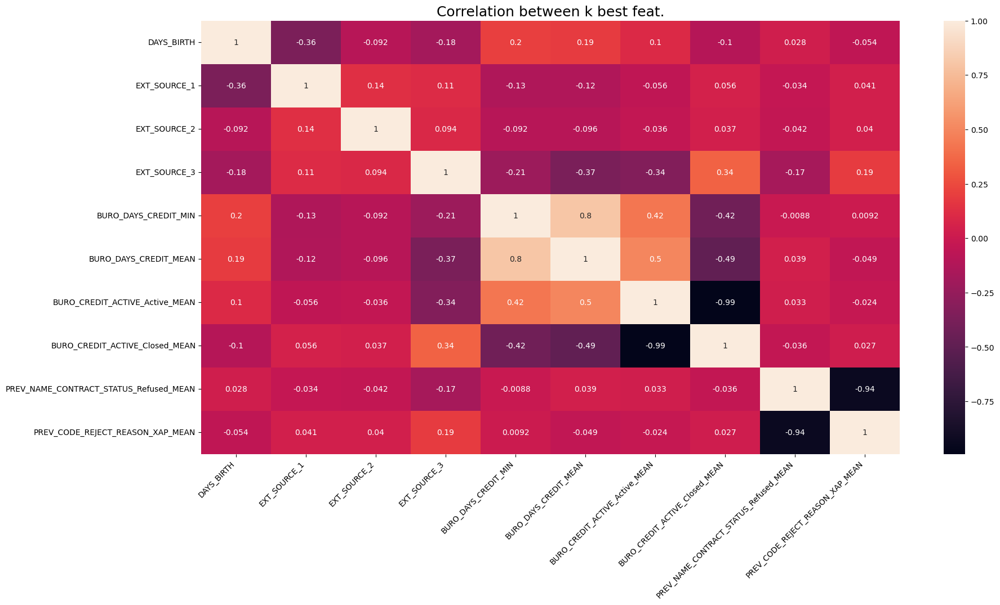

In [69]:
plt.figure(figsize=(20,10))
ax = sns.heatmap(pd.DataFrame(X_selkbest, columns=k_best_ft).corr(), annot=True)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.title('Correlation between k best feat.', fontsize =18)
plt.show()

In [70]:
k_best_ft

array(['DAYS_BIRTH', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       'BURO_DAYS_CREDIT_MIN', 'BURO_DAYS_CREDIT_MEAN',
       'BURO_CREDIT_ACTIVE_Active_MEAN', 'BURO_CREDIT_ACTIVE_Closed_MEAN',
       'PREV_NAME_CONTRACT_STATUS_Refused_MEAN',
       'PREV_CODE_REJECT_REASON_XAP_MEAN'], dtype='<U69')

In [71]:
selected_features = ['DAYS_BIRTH',
                     'EXT_SOURCE_1',
                     'EXT_SOURCE_2',
                     'EXT_SOURCE_3',
                     'BURO_DAYS_CREDIT_MEAN',
                     'BURO_DAYS_CREDIT_UPDATE_MEAN',
                     'BURO_CREDIT_ACTIVE_Active_MEAN',
                     'PREV_NAME_CONTRACT_STATUS_Refused_MEAN',
                    ]

In [72]:
df = df_train[selected_features].copy()


df.head()

,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
0,-9461,0.083008,0.262939,0.139404,-874.000000,-499.875000,0.250,0.000000
1,-16765,0.311279,0.622070,0.535156,-1400.750000,-816.000000,0.250,0.000000
2,-19046,0.505859,0.556152,0.729492,-867.000000,-532.000000,0.000,0.000000
3,-19005,0.505859,0.650391,0.535156,-1050.571429,-481.833333,0.375,0.111111
4,-19932,0.505859,0.322754,0.535156,-1149.000000,-783.000000,0.000,0.000000


In [73]:
df.to_csv('data_train.csv', index=False)

### JSon Characters

In [74]:
# Change columns names ([LightGBM] Do not support special JSON characters in feature name.)
new_names = {col: re.sub(r'[^A-Za-z0-9_]+', '', col) for col in X_sel.columns}
new_n_list = list(new_names.values())
        
# [LightGBM] Feature appears more than one time.
new_names = {col: f'{new_col}_{i}' if new_col in new_n_list[:i] else new_col for i, (col, new_col) in enumerate(new_names.items())}

X_sel = X_sel.rename(columns=new_names)

In [75]:
X_sel[selected_features].head()

,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
0,-9461,0.083008,0.262939,0.139404,-874.000000,-499.875000,0.250,0.000000
1,-16765,0.311279,0.622070,0.535156,-1400.750000,-816.000000,0.250,0.000000
2,-19046,0.505859,0.556152,0.729492,-867.000000,-532.000000,0.000,0.000000
3,-19005,0.505859,0.650391,0.535156,-1050.571429,-481.833333,0.375,0.111111
4,-19932,0.505859,0.322754,0.535156,-1149.000000,-783.000000,0.000,0.000000


## Train Test Split

In [76]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X_sel[selected_features], y_sel, test_size=0.30,
                                                 random_state=0)

## Model classifier

In [77]:
# X_tr = X_train.copy()
# X_tst = X_val.copy()
# y_tr = y_train.copy()
# y_tst = y_val.copy()   

oversample = SMOTE(random_state=42)
# X_tr, y_tr = oversample.fit_resample(X_tr, y_tr)
# X_tst, y_tst = oversample.fit_resample(X_tst, y_tst)

In [78]:

def roc_plot(gridmodel, X, y):
    from sklearn.metrics import roc_curve
    y_pred_prob = gridmodel.predict_proba(X)
    fpr, tpr, thresholds = roc_curve(y, y_pred_prob[:,1])

    auc = roc_auc_score(y ,y_pred_prob[:,1])
    plt.figure(figsize=(8,6))
    plt.plot(fpr, tpr, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.title('ROC curve', fontsize = 20)
    plt.xlabel('FPR', fontsize=15)
    plt.ylabel('TPR', fontsize=15)
    plt.grid()
    plt.legend(["AUC=%.3f"%auc])
    plt.savefig('roc_auc_curve.png')
    plt.show()
    return auc

    
def display_ft_importance(gridmodel, X_tr):   
#     best_feat = pd.DataFrame({'Features': X_tr.columns, 'Importance': gridmodel.best_estimator_.coef_[0]})
    best_feat = pd.DataFrame({'Features': X_tr.columns, 'Importance': gridmodel.best_estimator_.feature_importances_})
    best_feat.sort_values('Importance', ascending=False)
    print(best_feat.head(10))
    
    # Local importance
#     importances = gridmodel.best_estimator_.coef_[0]
    importances = gridmodel.best_estimator_.feature_importances_
    indices = np.argsort(importances)
    features = X_tr.columns
    plt.title('Feature Importances')
    plt.barh(range(len(indices)), importances[indices], color='b', align='center')
    plt.yticks(range(len(indices)), [features[i] for i in indices])
    plt.xlabel('Relative Importance')
    plt.savefig('ft_importances.png')
    plt.show()
    return best_feat


    
def shap_plot(model):
    # SHAP
    shap_model = model.fit(X_train, y_train)
    
    X_importance = X_val
    
    # Explain model predictions using shap library:
    explainer = shap.Explainer(shap_model, X_val)
    shap_values = explainer(X_importance)
#     shap_values = shap.KernelExplainer(gridmodel.predict, X_importance)
    
    
    # plot
    shap.plots.waterfall(shap_values[0])
    plt.savefig('SHAP_waterfall.png')
    plt.show()
    
    shap.plots.beeswarm(shap_values)
    plt.savefig('SHAP_beeswarm.png')
    plt.show()
    
    shap.plots.force(shap_values[1])
    plt.savefig('SHAP_force.png')
    plt.show()
    return shap_model


## MLFLOW env

In [79]:
# pip install pytest

In [80]:
# pip install mlflow

In [81]:
from sklearn.utils._testing import ignore_warnings

In [82]:
import mlflow

In [83]:
experiment_name = 'Classifier'

In [84]:
mlflow.set_tracking_uri("http://127.0.0.1:5000")
# experiment_id = '0'
# experiment = mlflow.get_experiment(experiment_id)
mlflow.set_experiment(experiment_name)

# mlflow.sklearn.autolog(log_models=True)

<Experiment: artifact_location='mlflow-artifacts:/322513538506252697', creation_time=1681046638357, experiment_id='322513538506252697', last_update_time=1681046638357, lifecycle_stage='active', name='Classifier', tags={}>

### Dummy Classifier

In [85]:
import time

start = time.time()

In [86]:
from sklearn.dummy import DummyClassifier
from sklearn.metrics import roc_curve

In [87]:
model_dummy = DummyClassifier()


param_dummy={
    
    'classifier__strategy': ['stratified', 'most_frequent', 'uniform']

}
pipe = imbpipl(steps= [['smote', oversample],
                     ['scaler', StandardScaler()],
                       ['classifier',model_dummy]] )

scores = {'auc': 'roc_auc_ovr_weighted',
             'f1':'f1',
             'cost':loan_score}

cv = mod.StratifiedKFold(n_splits = 5, shuffle = True, random_state=42)

gridmodel= GridSearchCV(pipe,
                         param_grid= param_dummy,
                         scoring = scores, refit='cost', cv = cv, error_score='raise', n_jobs=2)

Fit time: 10.170 seconds
Test time: 0.010 seconds


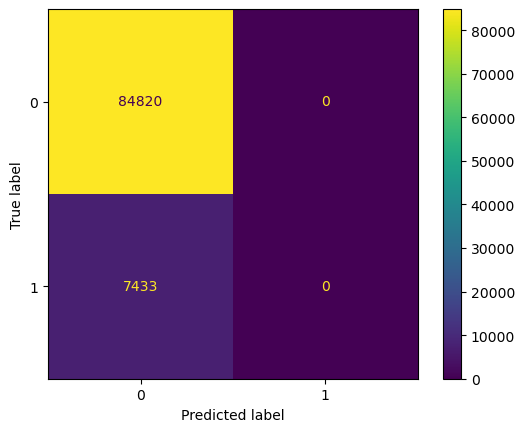

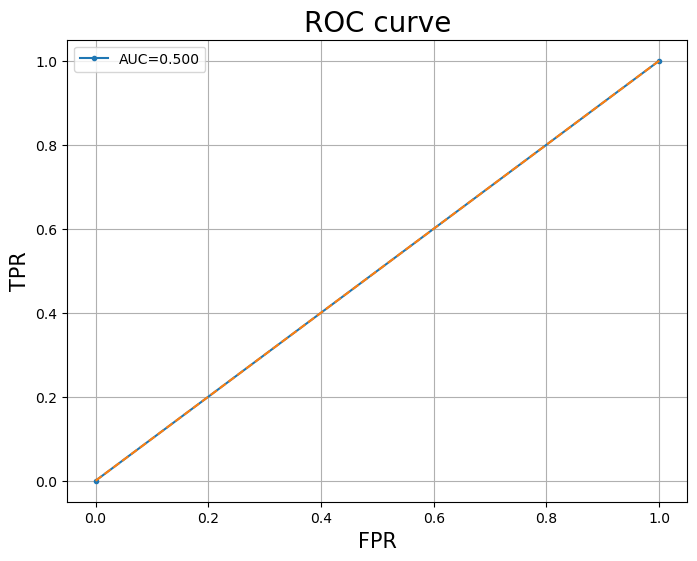

AUC  0.5
best params {'classifier__strategy': 'most_frequent'}


In [88]:
with mlflow.start_run(run_name='Dummy Classifier') as run:
    # Fit on training df
    start = time.time()
    gridmodel.fit(X_train, y_train)
    timer_dm = round(time.time() -start,2)
    
    # Prediction on test df
    start = time.time()
    y_pred = gridmodel.predict(X_val)
    test_dm = round(time.time() -start,2)
    
    print(f"Fit time: {timer_dm:.3f} seconds")
    print(f"Test time: {test_dm:.3f} seconds")
    
    # Confusion Matrix
    create_confusion_matrix_plot(gridmodel, X_val, y_val)

    # ROC
    roc_plot(gridmodel, X_val, y_val)
    
    y_pred_prob = gridmodel.predict_proba(X_val)

    auc_dm = round(roc_auc_score(y_val ,y_pred_prob[:,1]), 3)

    best_param_dm = gridmodel.best_params_

    print('AUC ', auc_dm)
    print('best params', best_param_dm)

### Linear Classification : Logistic Regression

In [89]:
from sklearn.linear_model import SGDClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline

In [156]:
# classifier = LogisticRegression()
# feature_selector =SelectKBest(chi2, k=50)
# standardscaler = StandardScaler()

C = np.logspace(-4, 4, 50)
penalty = ['l1', 'l2']

model_logr = LogisticRegression()
# Pipeline([
#     ('standardscaler', standardscaler),
#     ("feature_selector", feature_selector),
#     ("classifier", classifier)
# ])
    
param_logr={'classifier__penalty' : ['l2'],
    'classifier__solver' : ['lbfgs', 'newton-cg'],
            'classifier__C' : [1,10],
              'classifier__max_iter' : [1e5]
           }
pipe = imbpipl(steps= [['smote', oversample],
                     ['scaler', StandardScaler()],
                       ['classifier',model_logr]] )
    
    
cv = mod.StratifiedKFold(n_splits = 5, shuffle = True, random_state=42)

gridmodel = HalvingGridSearchCV(pipe,
                         param_grid= param_logr,
                         scoring = loan_score, refit=True, cv = cv, error_score='raise', n_jobs=2)
    

Fit time: 13.430 seconds
Test time: 0.010 seconds


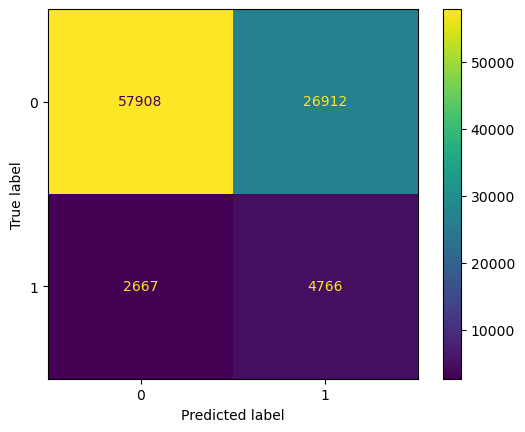

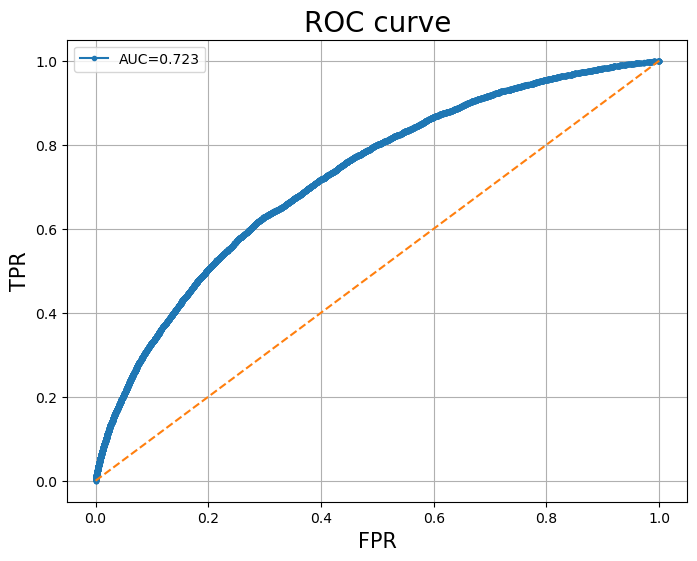

AUC  0.723
best params {'classifier__C': 10, 'classifier__max_iter': 100000.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}


In [157]:
with mlflow.start_run(run_name='Logistic Regression') as run:
    # Fit on training df
    start = time.time()
    gridmodel.fit(X_train, y_train)
    timer_lr = round(time.time() -start,2)
    
    # Prediction on test df
    start = time.time()
    y_pred = gridmodel.predict(X_val)
    test_lr = round(time.time() -start,2)
    
    print(f"Fit time: {timer_lr:.3f} seconds")
    print(f"Test time: {test_lr:.3f} seconds")
    
    # Confusion Matrix
    create_confusion_matrix_plot(gridmodel, X_val, y_val)

    # ROC
    roc_plot(gridmodel, X_val, y_val)
    
    y_pred_prob = gridmodel.predict_proba(X_val)

    auc_lr = round(roc_auc_score(y_val ,y_pred_prob[:,1]), 3)

    best_param_lr = gridmodel.best_params_

    print('AUC ', auc_lr)
    print('best params', best_param_lr)

In [158]:
shap_model = model_logr.fit(X_train, y_train)
    
X_importance = X_val
    
# Explain model predictions using shap library:
explainer = shap.Explainer(shap_model, X_val)
shap_values = explainer(X_importance)

C:\Users\Rahamane\anaconda3\lib\site-packages\shap\plots\_beeswarm.py:340: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



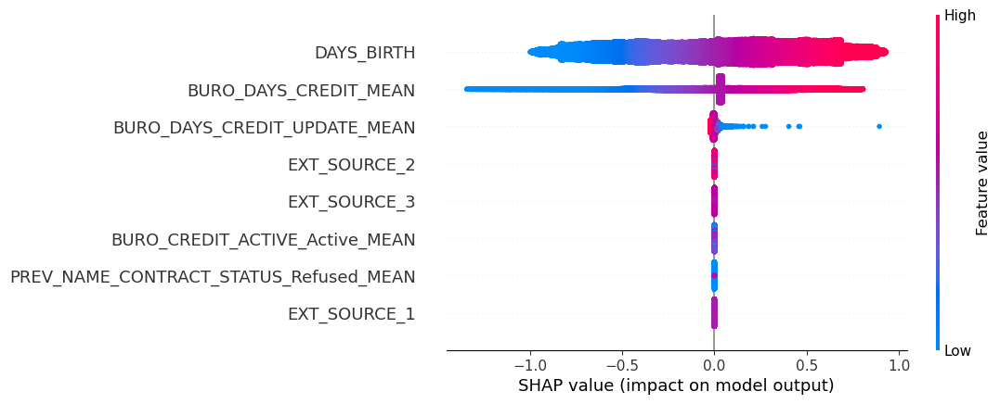

In [159]:
shap.plots.beeswarm(shap_values)

In [160]:
importances = gridmodel.best_estimator_.named_steps['classifier'].coef_[0]
importances

array([ 0.04530796, -0.27021242, -0.5658526 , -0.47969472, -0.02236737,
        0.02951732,  0.03680467,  0.19357835])

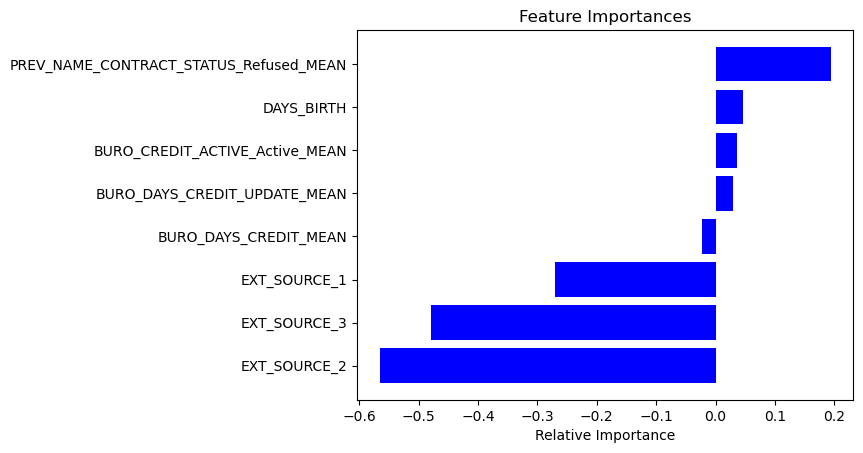

In [161]:

# importances = gridmodel.best_estimator_.feature_importances_
indices = np.argsort(importances)
features = X_train.columns
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.savefig('ft_importances.png')
plt.show()

In [162]:
gridmodel.best_params_

{'classifier__C': 10,
 'classifier__max_iter': 100000.0,
 'classifier__penalty': 'l2',
 'classifier__solver': 'lbfgs'}

In [163]:
best_params = {'C': 1,
              'max_iter': 100000.0,
              'solver': 'lbfgs',
              'penalty': 'l2',}

### Pipeline de prédiction

In [164]:
pipeline = imbpipl(steps= [('smote', SMOTE(random_state=42)),
                     ('scaler', StandardScaler()),
                       ['classifier',LogisticRegression(**best_params)]] )

In [165]:
pipeline = pipeline.fit(X_train, y_train)

In [166]:
from pathlib import Path
import os 


In [167]:
import pickle
import joblib

In [224]:
joblib.dump(pipeline,'trained_ppl.pkl')

['trained_ppl.pkl']

In [169]:
joblib.dump(shap_values,'shap_values_test.pkl')

with open('shap_values_test.pkl', 'rb') as f:
    shap_data = joblib.load(f)
shap_data

.values =
array([[ 5.43170661e-01, -1.58376282e-07, -1.02347456e-06, ...,
        -1.13503027e-02, -2.90577010e-07,  1.90885587e-07],
       [-1.55082824e-01, -2.59627271e-07,  1.36999554e-07, ...,
         3.10438254e-03, -1.85846443e-09, -1.10696119e-07],
       [ 6.76689387e-01, -1.86692237e-07,  4.51423912e-07, ...,
         1.18054320e-03, -4.62767022e-08, -1.10696119e-07],
       ...,
       [-3.67284191e-01,  5.51303055e-09,  1.06372398e-06, ...,
        -1.41105939e-02,  4.42323913e-07, -1.10696119e-07],
       [ 8.95594163e-01,  5.51303055e-09,  5.10378479e-07, ...,
        -2.21285827e-02, -5.34877318e-07,  2.91412822e-07],
       [-2.25963136e-01,  5.51303055e-09, -7.15255943e-07, ...,
        -1.71849282e-03,  7.58734517e-08, -1.10696119e-07]])

.base_values =
array([-2.55946733, -2.55946733, -2.55946733, ..., -2.55946733,
       -2.55946733, -2.55946733])

.data =
array([[-1.11890000e+04,  5.99121094e-01,  7.82226562e-01, ...,
        -2.62000000e+02,  7.50000000e-01,  2.5

In [225]:
with open('trained_ppl.pkl', 'rb') as f:
    tr_ppl = joblib.load(f)
tr_ppl

Pipeline(steps=[('smote', SMOTE(random_state=42)), ('scaler', StandardScaler()),
                ['classifier', LogisticRegression(C=1, max_iter=100000.0)]])

In [171]:
tr_ppl.predict(X_val)

array([1, 1, 1, ..., 1, 1, 1], dtype=int8)

In [172]:
with open('shap_values_test_set.pkl', 'rb') as f:
    shap_data = pickle.load(f)

In [173]:
shap_data

.values =
array([[ 0.        , -0.02714286,  0.        , ..., -0.02821429,
         0.        , -0.01571429],
       [ 0.        , -0.04392857,  0.        , ..., -0.03678571,
         0.        , -0.0325    ],
       [ 0.        , -0.01571429,  0.        , ...,  0.03964286,
         0.        , -0.02035714],
       ...,
       [ 0.        ,  0.13214286,  0.        , ..., -0.05035714,
         0.        , -0.03285714],
       [ 0.        ,  0.09571429,  0.        , ..., -0.03      ,
         0.        , -0.03      ],
       [ 0.        , -0.03071429,  0.        , ...,  0.05142857,
         0.        , -0.02285714]])

.base_values =
array([0.39, 0.39, 0.39, ..., 0.39, 0.39, 0.39])

.data =
array([[-0.00583883, -0.55179858, -0.00275241, ..., -1.07705499,
        -0.04272339, -0.49232208],
       [-0.00583883, -0.55179858, -0.00275241, ..., -1.07705499,
        -0.04272339, -0.49232208],
       [-0.00583883, -0.55179858, -0.00275241, ...,  0.9284577 ,
        -0.04272339, -0.49232208],
   

### Linear Classification :  SGDClassifier

In [174]:
from sklearn.linear_model import SGDClassifier
from sklearn.calibration import CalibratedClassifierCV

In [175]:
model_sgd = SGDClassifier()

param_sgd= {'classifier__alpha': [1e-3, 1e1, 1e3],# learning rate
                              'classifier__loss': ['log'], # logistic regression,
                      'classifier__penalty': ['l2']}

pipe = imbpipl(steps= [['smote', oversample],
                     ['scaler', StandardScaler()],
                       ['classifier',model_sgd]] )
    
    
cv = mod.StratifiedKFold(n_splits = 5, shuffle = True, random_state=42)
    
scores = {'auc': 'roc_auc_ovr_weighted',
             'f1':'f1',
             'cost':loan_score}
    
gridmodel= HalvingGridSearchCV(pipe,
                         param_grid= param_sgd,
                         scoring = loan_score, refit=True, cv = cv, error_score='raise', n_jobs=2)

Fit time: 6.410 seconds
Test time: 0.010 seconds


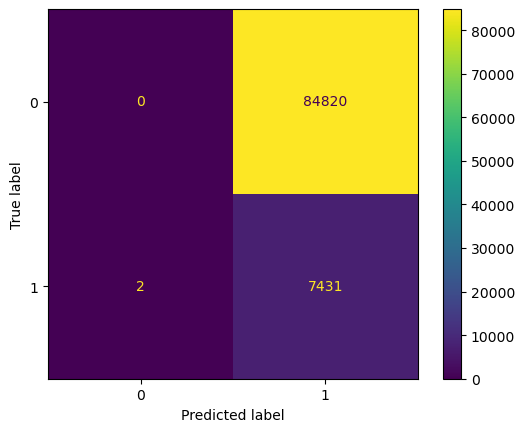

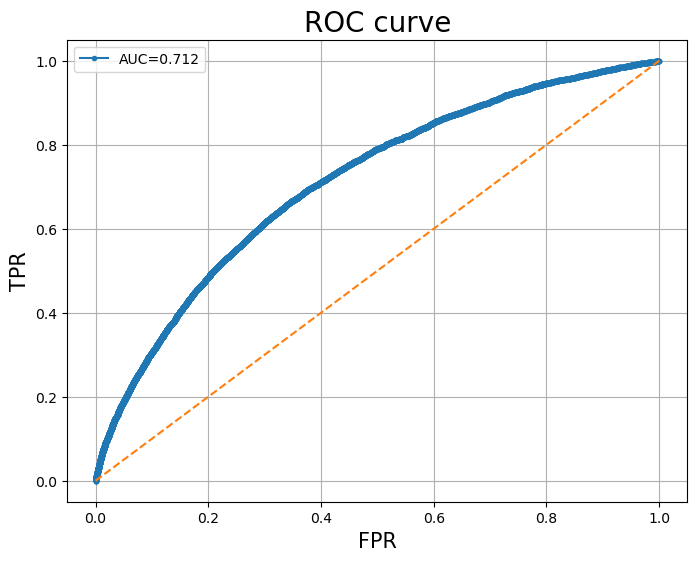

AUC  0.712
best params {'classifier__alpha': 10.0, 'classifier__loss': 'log', 'classifier__penalty': 'l2'}


In [176]:
with mlflow.start_run(run_name='SGD Classifier') as run:
    # Fit on training df
    start = time.time()
    gridmodel.fit(X_train, y_train)
    timer_sgd = round(time.time() -start,2)
    
    # Prediction on test df
    start = time.time()
    y_pred = gridmodel.predict(X_val)
    test_sgd = round(time.time() -start,2)
    
    print(f"Fit time: {timer_sgd:.3f} seconds")
    print(f"Test time: {test_sgd:.3f} seconds")
    
    # Confusion Matrix
    create_confusion_matrix_plot(gridmodel, X_val, y_val)

    # ROC
    roc_plot(gridmodel, X_val, y_val)
    
    y_pred_prob = gridmodel.predict_proba(X_val)

    auc_sgd = round(roc_auc_score(y_val ,y_pred_prob[:,1]), 3)

    best_param_sgd = gridmodel.best_params_

    print('AUC ', auc_sgd)
    print('best params', best_param_sgd)

### LGBM Classifier

In [121]:
model_lgbm = LGBMClassifier(
#             nthread=4,
            n_estimators=10000,
            learning_rate=0.02,
            num_leaves=34,
            colsample_bytree=0.95,
            subsample=0.9,
            max_depth=8,
            reg_alpha=0.041545473,
            reg_lambda=0.0735294,
            min_split_gain=0.0222415,
            min_child_weight=39.3259775)

param_lgbm = {'classifier__learning_rate': [0.01,0.02,0.03],
              'classifier__subsample'    : [0.9, 0.5, 0.2],
              'classifier__n_estimators' : [100,500,1000],
              'classifier__max_depth'    : [4,6,8]
             }

pipe = imbpipl(steps= [['smote', oversample],
                     ['scaler', StandardScaler()],
                       ['classifier',model_lgbm]] )
    
    
cv = mod.StratifiedKFold(n_splits = 5, shuffle = True, random_state=42)

    
gridmodel= HalvingGridSearchCV(pipe,
                         param_grid= param_lgbm,
                         scoring = loan_score, refit=True, cv = cv, error_score='raise', n_jobs=2)

Fit time: 311.260 seconds
Test time: 1.050 seconds


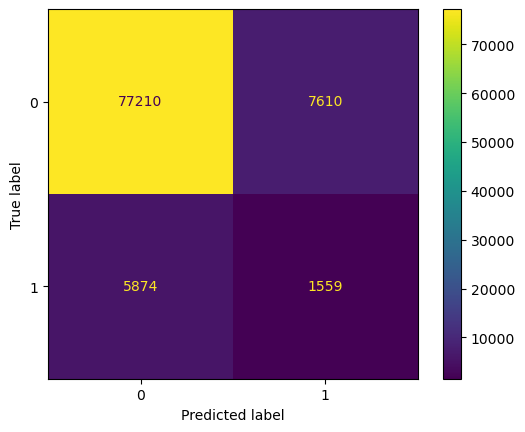

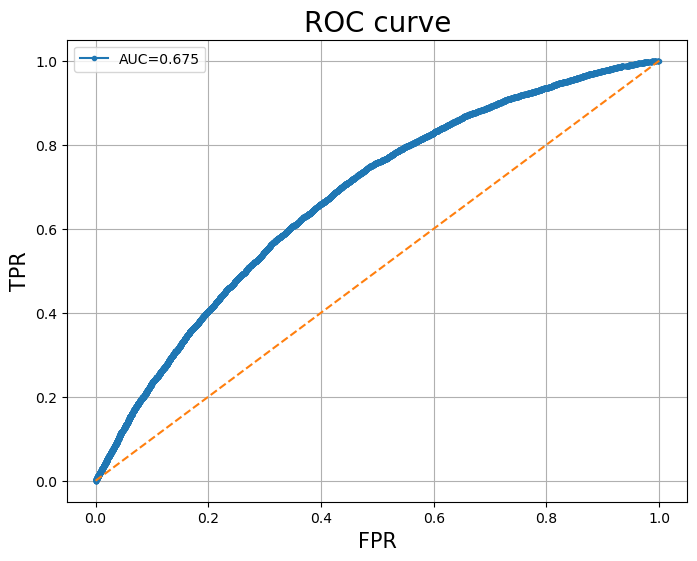

AUC  0.675
best params {'classifier__learning_rate': 0.03, 'classifier__max_depth': 8, 'classifier__n_estimators': 1000, 'classifier__subsample': 0.2}


In [123]:
with mlflow.start_run(run_name='LGBM Classifier') as run:
    # Fit on training df
    start = time.time()
    gridmodel.fit(X_train, y_train)
    timer_lgbm = round(time.time() -start,2)
    
    # Prediction on test df
    start = time.time()
    y_pred = gridmodel.predict(X_val)
    test_lgbm = round(time.time() -start,2)
    
    print(f"Fit time: {timer_lgbm:.3f} seconds")
    print(f"Test time: {test_lgbm:.3f} seconds")
    
    # Confusion Matrix
    create_confusion_matrix_plot(gridmodel, X_val, y_val)

    # ROC
    roc_plot(gridmodel, X_val, y_val)
    
    y_pred_prob = gridmodel.predict_proba(X_val)

    auc_lgbm = round(roc_auc_score(y_val ,y_pred_prob[:,1]), 3)

    best_param_lgbm = gridmodel.best_params_

    print('AUC ', auc_lgbm)
    print('best params', best_param_lgbm)

### Non-Linear Classifier : Random Forest

In [124]:
from sklearn.ensemble import RandomForestClassifier

In [125]:
model_rfc = RandomForestClassifier(random_state=42)

param_rfc= { 
    'classifier__n_estimators': [200],
    'classifier__max_features': ['log2'],
    'classifier__max_depth' : [4,6,8], #20 -60
    'classifier__criterion' :['gini']
}

pipe = imbpipl(steps= [['smote', oversample],
                     ['scaler', StandardScaler()],
                       ['classifier',model_rfc]] )
    
    
cv = mod.StratifiedKFold(n_splits = 5, shuffle = True, random_state=42)
    
gridmodel= HalvingGridSearchCV(pipe,
                         param_grid= param_rfc,
                         scoring = loan_score, refit=True, cv = cv, error_score='raise', n_jobs=2)

Fit time: 688.480 seconds
Test time: 1.730 seconds


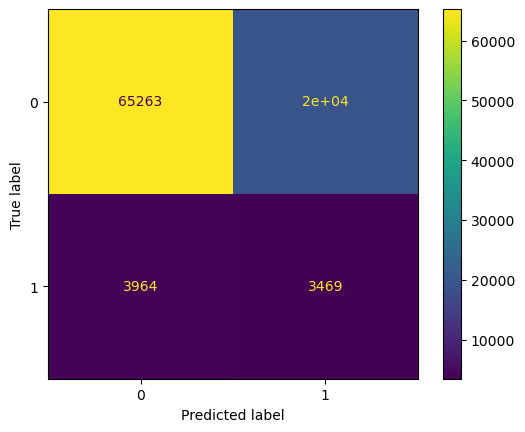

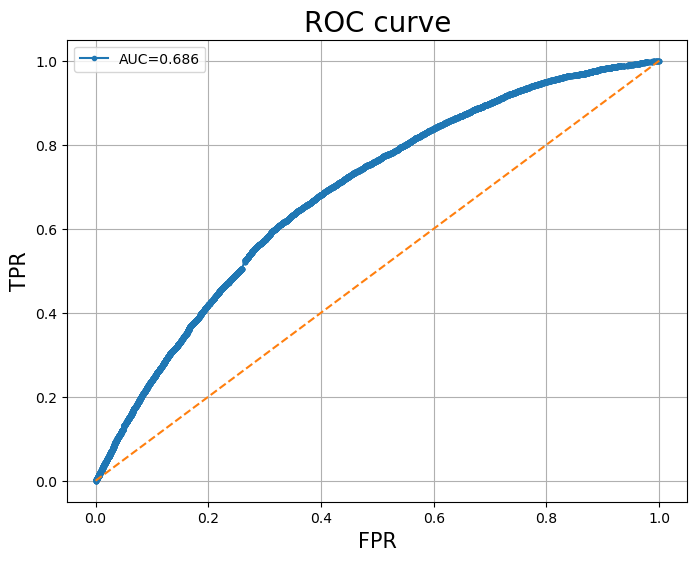

AUC  0.686
best params {'classifier__criterion': 'gini', 'classifier__max_depth': 8, 'classifier__max_features': 'log2', 'classifier__n_estimators': 200}


In [126]:
with mlflow.start_run(run_name='Random Forest Classifier') as run:
    # Fit on training df
    start = time.time()
    gridmodel.fit(X_train, y_train)
    timer_rfc = round(time.time() -start,2)
    
    # Prediction on test df
    start = time.time()
    y_pred = gridmodel.predict(X_val)
    test_rfc = round(time.time() -start,2)
    
    print(f"Fit time: {timer_rfc:.3f} seconds")
    print(f"Test time: {test_rfc:.3f} seconds")
    
    # Confusion Matrix
    create_confusion_matrix_plot(gridmodel, X_val, y_val)

    # ROC
    roc_plot(gridmodel, X_val, y_val)
    
    y_pred_prob = gridmodel.predict_proba(X_val)

    auc_rfc = round(roc_auc_score(y_val ,y_pred_prob[:,1]), 3)

    best_param_rfc = gridmodel.best_params_

    print('AUC ', auc_rfc)
    print('best params', best_param_rfc)

### Non-Linear Classifier : XGBoost

In [127]:
import xgboost as xgb

In [128]:
model_xgb = xgb.XGBClassifier(
    objective= 'binary:logistic',
    nthread=4,
    seed=42
)    

param_xgb= {
    'classifier__max_depth': range (2, 10, 1),
    'classifier__n_estimators': range(60, 220, 40),
    'classifier__learning_rate': [0.1, 0.01, 0.05]
}

pipe = imbpipl(steps= [['smote', oversample],
                     ['scaler', StandardScaler()],
                       ['classifier',model_xgb]] )
    
    
cv = mod.StratifiedKFold(n_splits = 5, shuffle = True, random_state=42)
    
    
gridmodel= HalvingGridSearchCV(pipe,
                         param_grid= param_xgb,
                         scoring = loan_score, refit=True, cv = cv, error_score='raise', n_jobs=2)

Fit time: 713.690 seconds
Test time: 0.230 seconds


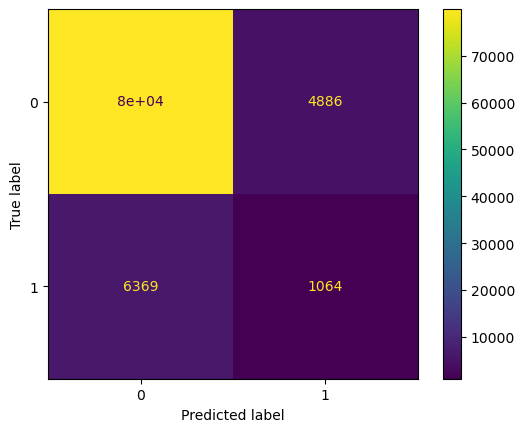

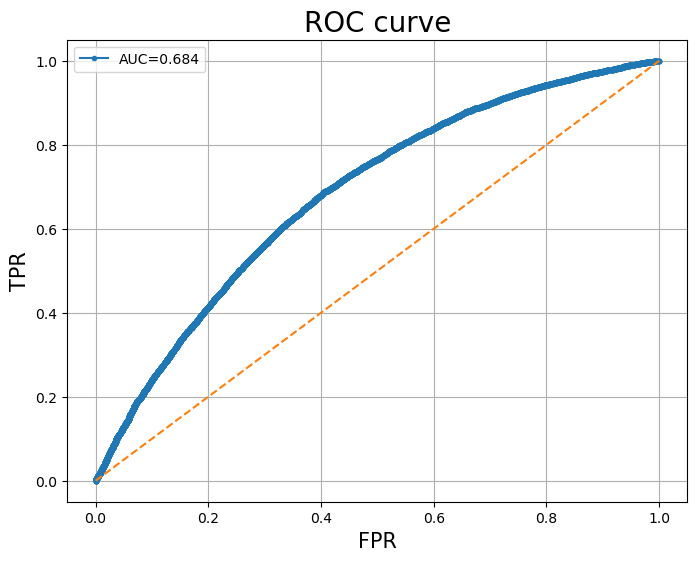

AUC  0.684
best params {'classifier__learning_rate': 0.1, 'classifier__max_depth': 9, 'classifier__n_estimators': 180}


In [129]:
with mlflow.start_run(run_name='XGB Classifier') as run:
    # Fit on training df
    start = time.time()
    gridmodel.fit(X_train, y_train)
    timer_xgb = round(time.time() -start,2)
    
    # Prediction on test df
    start = time.time()
    y_pred = gridmodel.predict(X_val)
    test_xgb = round(time.time() -start,2)
    
    print(f"Fit time: {timer_xgb:.3f} seconds")
    print(f"Test time: {test_xgb:.3f} seconds")
    
    # Confusion Matrix
    create_confusion_matrix_plot(gridmodel, X_val, y_val)

    # ROC
    roc_plot(gridmodel, X_val, y_val)
    
    y_pred_prob = gridmodel.predict_proba(X_val)

    auc_xgb = round(roc_auc_score(y_val ,y_pred_prob[:,1]), 3)

    best_param_xgb = gridmodel.best_params_

    print('AUC ', auc_xgb)
    print('best params', best_param_xgb)

## ML Classifiers : summary

In [186]:
data_score = {'Model Classifier': ['Dummy', 'Logistic Regression', 'SGD',
                        'LGBM', 'Random Forest', 'XGBoost'],
             'Fit Time (s)' : [timer_dm, timer_lr, timer_sgd, timer_lgbm, timer_rfc, timer_xgb],
              'Test Time (s)' : [test_dm, test_lr, test_sgd, test_lgbm, test_rfc, test_xgb],
              
             'AUC score' : [auc_dm, auc_lr, auc_sgd, auc_lgbm, auc_rfc, auc_xgb],
#              'Best params' : [best_param_dm, best_param_lr, best_param_sgd,
#                               best_param_lgbm, best_param_rfc, best_param_xgb]
             }

In [187]:
df_scores = pd.DataFrame(data_score)
df_scores

,Model Classifier,Fit Time (s),Test Time (s),AUC score
0,Dummy,10.17,0.01,0.500
1,Logistic Regression,13.43,0.01,0.723
2,SGD,6.41,0.01,0.712
3,LGBM,311.26,1.05,0.675
4,Random Forest,688.48,1.73,0.686
5,XGBoost,713.69,0.23,0.684


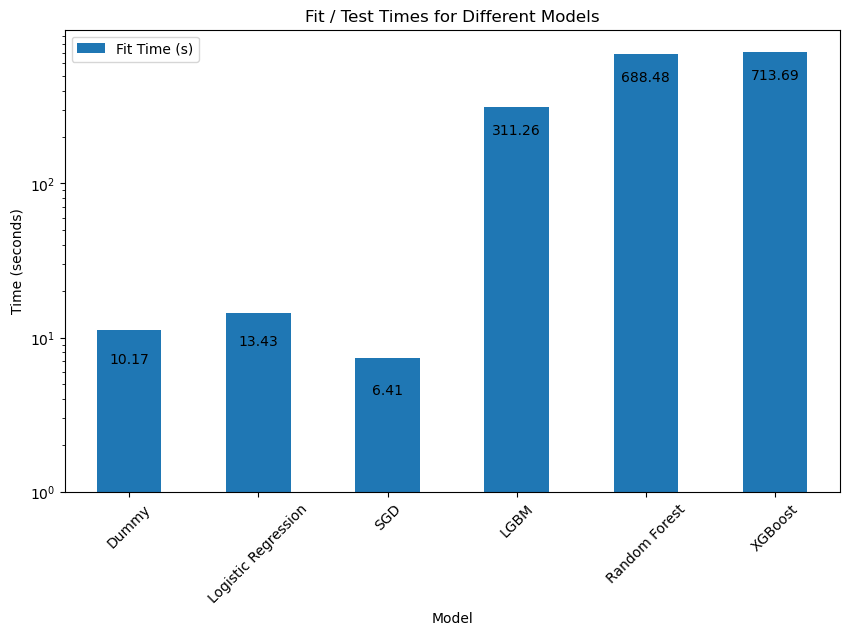

In [210]:
fig, ax = plt.subplots(figsize=(10, 6))

df_scores.plot(kind='bar', x='Model Classifier', y=['Fit Time (s)'], ax=ax, log=True)
ax.set_title('Fit / Test Times for Different Models')
ax.set_xlabel('Model')
plt.xticks(rotation=45)
# Add count labels
for p in ax.patches:
    ax.annotate(f'\n{p.get_height()}', (p.get_x()+0.25, p.get_height()), ha='center',
                va='top', color='black')

ax.set_ylabel('Time (seconds)')
plt.show()

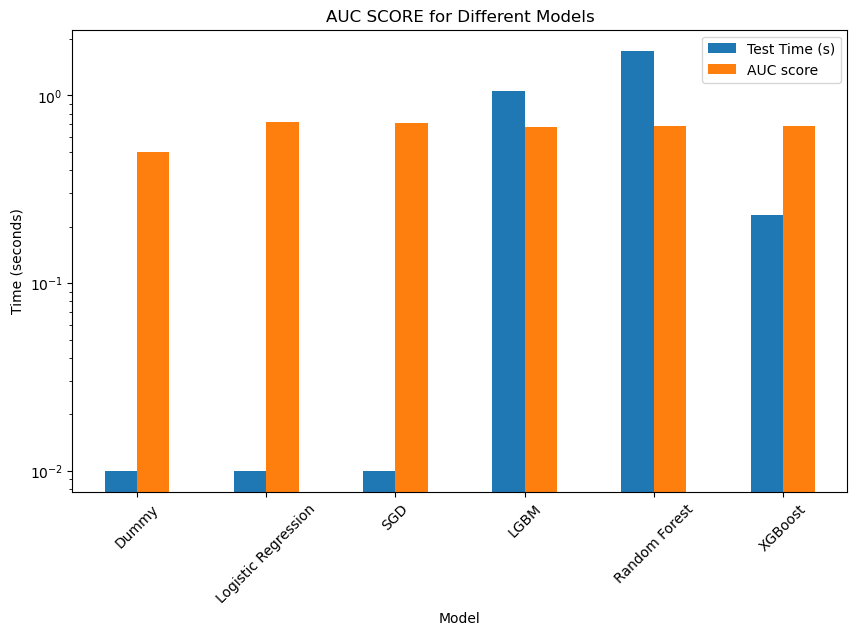

In [213]:
# create a bar plot
fig, ax = plt.subplots(figsize=(10, 6))
df_scores.plot(kind='bar', x='Model Classifier', y=['Test Time (s)','AUC score'], ax=ax, log=True)
ax.set_title('AUC SCORE for Different Models')
ax.set_xlabel('Model')
plt.xticks(rotation=45)

ax.set_ylabel('Time (seconds)')
plt.show()

## Saving Dataframe for API

In [214]:
df_t[selected_features].head()

,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
0,-19241,0.752441,0.789551,0.159546,-735.000000,-93.142857,0.428571,0.0
1,-18064,0.564941,0.291748,0.432861,-190.666667,-54.333333,0.666667,0.0
2,-20038,NaN,0.699707,0.610840,-1737.500000,-775.500000,0.000000,0.0
3,-13976,0.525879,0.509766,0.612793,-1401.750000,-651.500000,0.416667,0.0
4,-13040,0.202148,0.425781,NaN,NaN,NaN,NaN,0.0


In [215]:
selected_features

['DAYS_BIRTH',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'BURO_DAYS_CREDIT_MEAN',
 'BURO_DAYS_CREDIT_UPDATE_MEAN',
 'BURO_CREDIT_ACTIVE_Active_MEAN',
 'PREV_NAME_CONTRACT_STATUS_Refused_MEAN']

In [216]:
df_api = df_t[['SK_ID_CURR','DAYS_BIRTH',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'BURO_DAYS_CREDIT_MEAN',
 'BURO_DAYS_CREDIT_UPDATE_MEAN',
 'BURO_CREDIT_ACTIVE_Active_MEAN',
 'PREV_NAME_CONTRACT_STATUS_Refused_MEAN']].copy()


df_api.head()

,SK_ID_CURR,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
0,100001,-19241,0.752441,0.789551,0.159546,-735.000000,-93.142857,0.428571,0.0
1,100005,-18064,0.564941,0.291748,0.432861,-190.666667,-54.333333,0.666667,0.0
2,100013,-20038,NaN,0.699707,0.610840,-1737.500000,-775.500000,0.000000,0.0
3,100028,-13976,0.525879,0.509766,0.612793,-1401.750000,-651.500000,0.416667,0.0
4,100038,-13040,0.202148,0.425781,NaN,NaN,NaN,NaN,0.0


In [217]:
df_api = df_api.fillna(df_api.median())
df_api.head()

,SK_ID_CURR,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
0,100001,-19241,0.752441,0.789551,0.159546,-735.000000,-93.142857,0.428571,0.0
1,100005,-18064,0.564941,0.291748,0.432861,-190.666667,-54.333333,0.666667,0.0
2,100013,-20038,0.506836,0.699707,0.610840,-1737.500000,-775.500000,0.000000,0.0
3,100028,-13976,0.525879,0.509766,0.612793,-1401.750000,-651.500000,0.416667,0.0
4,100038,-13040,0.202148,0.425781,0.519043,-1062.944444,-467.436508,0.333333,0.0


In [218]:
df_api[df_api['SK_ID_CURR'] == 456222]

,SK_ID_CURR,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
48740,456222,-11186,0.506836,0.68457,0.519043,-1062.944444,-467.436508,0.333333,0.0


In [219]:
df_api.to_csv('data_api.csv', index=False)

In [220]:
data_test = pd.read_csv('data_api.csv')
data_test.head()

,SK_ID_CURR,DAYS_BIRTH,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,PREV_NAME_CONTRACT_STATUS_Refused_MEAN
0,100001,-19241,0.7524,0.7896,0.1595,-735.000000,-93.142857,0.428571,0.0
1,100005,-18064,0.5650,0.2917,0.4329,-190.666667,-54.333333,0.666667,0.0
2,100013,-20038,0.5070,0.6997,0.6110,-1737.500000,-775.500000,0.000000,0.0
3,100028,-13976,0.5260,0.5100,0.6130,-1401.750000,-651.500000,0.416667,0.0
4,100038,-13040,0.2021,0.4258,0.5190,-1062.944444,-467.436508,0.333333,0.0


### Data Drift Analysis

In [221]:
train_data = pd.read_csv('data_train.csv')
test_data = pd.read_csv('data_api.csv')


train_data_ft = train_data[selected_features].copy()
test_data_ft = test_data[selected_features].copy()

In [222]:
from evidently.dashboard import Dashboard
from evidently.pipeline.column_mapping import ColumnMapping
from evidently.dashboard.tabs import DataDriftTab

from evidently.model_profile import Profile
from evidently.model_profile.sections import DataDriftProfileSection
reference_df = train_data_ft
production_df = test_data_ft

data_drift_dashboard = Dashboard(tabs=[DataDriftTab(verbose_level=0)]) #1 for full, 0 for short
data_drift_dashboard.calculate(reference_df, production_df)

data_drift_dashboard.show(mode="inline")

In [223]:
data_drift_dashboard.save('data_drift.html')